In [2]:
import os
import sys
import time
import numpy as np
import math
import json
import torch
import torch.nn as nn
import torch.nn.functional as F
import skimage.measure
import plyfile
from plyfile import PlyData
from sklearn.neighbors import KDTree
import trimesh
import torch_geometric
from torch_geometric.nn import (NNConv, GMMConv, GraphConv, Set2Set)
from torch_geometric.nn import (SplineConv, graclus, max_pool, max_pool_x, global_mean_pool)
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter("ignore")

In [3]:
def load_pressure_predictor(load_directory):
    model = SplineCNN8Residuals(3)
    model.load_state_dict(torch.load(load_directory + "/cfdModel.nn"))
    model = model.to("cuda:0").eval()
    return model

def load_latent_vectors(load_directory, checkpoint):
    filename = os.path.join(
        load_directory, checkpoint + ".pth"
    )
    if not os.path.isfile(filename):
        raise Exception(
            "The experiment directory ({}) does not include a latent code file"
            + " for checkpoint '{}'".format(load_directory, checkpoint)
        )
    data = torch.load(filename)
    return data["latent_codes"].cuda()

def load_decoder(load_directory, checkpoint):
    specs_filename = os.path.join(load_directory, "specs.json")
    if not os.path.isfile(specs_filename):
        raise Exception(
            'The experiment directory does not include specifications file "specs.json"'
        )
    specs = json.load(open(specs_filename))
    latent_size = specs["CodeLength"]
    decoder = Decoder(latent_size, **specs["NetworkSpecs"])
    decoder = torch.nn.DataParallel(decoder)
    saved_model_state = torch.load(os.path.join(load_directory, checkpoint +".pth"))
    decoder.load_state_dict(saved_model_state["model_state_dict"])
    decoder = decoder.module.cuda()
    decoder.eval()
    return decoder

In [4]:
from abc import ABC, abstractmethod

class objective_func(ABC):
    @abstractmethod
    def func(self, x):
        pass
    def dfunc(self, x):
        out = self.func(x)
        out.backward()
        return x.grad
    def get_optimal(self):
        return self.optimal
    def get_optimum(self):
        return self.optimum
    

class Decoder(nn.Module):
    def __init__(
        self,
        latent_size,
        dims,
        dropout=None,
        dropout_prob=0.0,
        norm_layers=(),
        latent_in=(),
        weight_norm=False,
        xyz_in_all=None,
        use_tanh=False,
        latent_dropout=False,
    ):
        super(Decoder, self).__init__()

        def make_sequence():
            return []

        dims = [latent_size + 3] + dims + [1]

        self.num_layers = len(dims)
        self.norm_layers = norm_layers
        self.latent_in = latent_in
        self.latent_dropout = latent_dropout
        if self.latent_dropout:
            self.lat_dp = nn.Dropout(0.2)

        self.xyz_in_all = xyz_in_all
        self.weight_norm = weight_norm

        for layer in range(0, self.num_layers - 1):
            if layer + 1 in latent_in:
                out_dim = dims[layer + 1] - dims[0]
            else:
                out_dim = dims[layer + 1]
                if self.xyz_in_all and layer != self.num_layers - 2:
                    out_dim -= 3

            if weight_norm and layer in self.norm_layers:
                setattr(
                    self,
                    "lin" + str(layer),
                    nn.utils.weight_norm(nn.Linear(dims[layer], out_dim)),
                )
            else:
                setattr(self, "lin" + str(layer), nn.Linear(dims[layer], out_dim))

            if (
                (not weight_norm)
                and self.norm_layers is not None
                and layer in self.norm_layers
            ):
                setattr(self, "bn" + str(layer), nn.LayerNorm(out_dim))

        self.use_tanh = use_tanh
        if use_tanh:
            self.tanh = nn.Tanh()
        self.relu = nn.ReLU()

        self.dropout_prob = dropout_prob
        self.dropout = dropout
        self.th = nn.Tanh()

    # input: N x (L+3)
    def forward(self, input):
        xyz = input[:, -3:]

        if input.shape[1] > 3 and self.latent_dropout:
            latent_vecs = input[:, :-3]
            latent_vecs = F.dropout(latent_vecs, p=0.2, training=self.training)
            x = torch.cat([latent_vecs, xyz], 1)
        else:
            x = input

        for layer in range(0, self.num_layers - 1):
            lin = getattr(self, "lin" + str(layer))
            if layer in self.latent_in:
                x = torch.cat([x, input], 1)
            elif layer != 0 and self.xyz_in_all:
                x = torch.cat([x, xyz], 1)
            x = lin(x)
            # last layer Tanh
            if layer == self.num_layers - 2 and self.use_tanh:
                x = self.tanh(x)
            if layer < self.num_layers - 2:
                if (
                    self.norm_layers is not None
                    and layer in self.norm_layers
                    and not self.weight_norm
                ):
                    bn = getattr(self, "bn" + str(layer))
                    x = bn(x)
                x = self.relu(x)
                if self.dropout is not None and layer in self.dropout:
                    x = F.dropout(x, p=self.dropout_prob, training=self.training)

        if hasattr(self, "th"):
            x = self.th(x)

        return x
class SplineBlock(nn.Module):
    def __init__(self, num_in_features, num_outp_features, mid_features, kernel=3, dim=3, batchnorm1=True):
        super(SplineBlock, self).__init__()
        self.batchnorm1 = batchnorm1
        self.conv1 = SplineConv(num_in_features, mid_features, dim, kernel, is_open_spline=False)
        if self.batchnorm1:
            self.batchnorm1 = torch.nn.BatchNorm1d(mid_features)
        self.conv2 = SplineConv(mid_features, 2 * mid_features, dim, kernel, is_open_spline=False)
        self.batchnorm2 = torch.nn.BatchNorm1d(2 * mid_features)
        self.conv3 = SplineConv(2 * mid_features + 3, num_outp_features, dim, kernel, is_open_spline=False)
  
    def forward(self, res, data):
        if self.batchnorm1:
            res = F.elu(self.batchnorm1(self.conv1(res, data['edge_index'], data['edge_attr'])))
        else:
            res = F.elu(self.conv1(res, data['edge_index'], data['edge_attr']))
        res = F.elu(self.batchnorm2(self.conv2(res, data['edge_index'], data['edge_attr'])))
#         res = F.elu(self.conv2(res, data.edge_index, data.edge_attr))
        res = torch.cat([res, data['x']], dim=1)
        res = self.conv3(res, data['edge_index'], data['edge_attr'])
        return res

class SplineCNN8Residuals(nn.Module):
    def __init__(self, num_features, kernel=3, dim=3):
        super(SplineCNN8Residuals, self).__init__()
        self.block1 = SplineBlock(num_features, 16, 8, kernel, dim)
        self.block2 = SplineBlock(16, 64, 32, kernel, dim)
        self.block3 = SplineBlock(64, 64, 128, kernel, dim)
        self.block4 = SplineBlock(64, 8, 16, kernel, dim)
        self.block5 = SplineBlock(11, 32, 16, kernel, dim)
        self.block6 = SplineBlock(32, 64, 32, kernel, dim)
        self.block7 = SplineBlock(64, 64, 128, kernel, dim)
        self.block8 = SplineBlock(75, 4, 16, kernel, dim)

    def forward(self, data):
        res = data['x']
        res = self.block1(res, data)
        res = self.block2(res, data)
        res = self.block3(res, data)
        res4 = self.block4(res, data)
        res = torch.cat([res4, data['x']], dim=1)
        res = self.block5(res, data)
        res = self.block6(res, data)
        res = self.block7(res, data)
        res = torch.cat([res, res4, data['x']], dim=1)
        res = self.block8(res, data)
        return res

def create_mesh(
    decoder, latent_vec, filename='', N=256, max_batch=32 ** 3, offset=None, scale=None
):
    ply_filename = filename

    decoder.eval()

    # NOTE: the voxel_origin is actually the (bottom, left, down) corner, not the middle
    voxel_origin = [-1, -1, -1]
    voxel_size = 2.0 / (N - 1)

    overall_index = torch.arange(0, N ** 3, 1, out=torch.LongTensor())
    samples = torch.zeros(N ** 3, 4)

    # transform first 3 columns
    # to be the x, y, z index
    samples[:, 2] = overall_index % N
    samples[:, 1] = (overall_index.long() // N) % N
    samples[:, 0] = ((overall_index.long() // N) // N) % N

    # transform first 3 columns
    # to be the x, y, z coordinate
    samples[:, 0] = (samples[:, 0] * voxel_size) + voxel_origin[2]
    samples[:, 1] = (samples[:, 1] * voxel_size) + voxel_origin[1]
    samples[:, 2] = (samples[:, 2] * voxel_size) + voxel_origin[0]

    num_samples = N ** 3

    samples.requires_grad = False
    head = 0

    while head < num_samples:
        sample_subset = samples[head : min(head + max_batch, num_samples), 0:3].cuda()
        num_subsample = min(max_batch, num_samples-head)
        latent_repeat = latent_vec.expand(num_subsample, -1)
        inputs = torch.cat([latent_repeat, sample_subset], 1)
        samples[head : min(head + max_batch, num_samples), 3] = \
                decoder(inputs).squeeze(1).detach().cpu()
        head += max_batch
        
    sdf_values = samples[:, 3].reshape(N, N, N).data.cpu()

    return convert_sdf_samples_to_ply(
        sdf_values,
        voxel_origin,
        voxel_size,
        ply_filename + ".ply",
        offset,
        scale,
    )

def convert_sdf_samples_to_ply(
    pytorch_3d_sdf_tensor,
    voxel_grid_origin,
    voxel_size,
    ply_filename_out,
    offset=None,
    scale=None,
):
    """
    Convert sdf samples to .ply

    :param pytorch_3d_sdf_tensor: a torch.FloatTensor of shape (n,n,n)
    :voxel_grid_origin: a list of three floats: the bottom, left, down origin of the voxel grid
    :voxel_size: float, the size of the voxels
    :ply_filename_out: string, path of the filename to save to

    This function adapted from: https://github.com/RobotLocomotion/spartan
    """

    numpy_3d_sdf_tensor = pytorch_3d_sdf_tensor.numpy()

    verts, faces, normals, values = skimage.measure.marching_cubes_lewiner(
        numpy_3d_sdf_tensor, level=0.0, spacing=[voxel_size] * 3
    )

    # transform from voxel coordinates to camera coordinates
    # note x and y are flipped in the output of marching_cubes
    mesh_points = np.zeros_like(verts)
    mesh_points[:, 0] = voxel_grid_origin[0] + verts[:, 0]
    mesh_points[:, 1] = voxel_grid_origin[1] + verts[:, 1]
    mesh_points[:, 2] = voxel_grid_origin[2] + verts[:, 2]

    # apply additional offset and scale
    if scale is not None:
        mesh_points = mesh_points / scale
    if offset is not None:
        mesh_points = mesh_points - offset

    # try writing to the ply file

    num_verts = verts.shape[0]
    num_faces = faces.shape[0]

    verts_tuple = np.zeros((num_verts,), dtype=[("x", "f4"), ("y", "f4"), ("z", "f4")])
    norms_tuple = np.zeros((num_verts,), dtype=[("x", "f4"), ("y", "f4"), ("z", "f4")])

    for i in range(0, num_verts):
        verts_tuple[i] = tuple(mesh_points[i, :])
        norms_tuple[i] = tuple(normals[i, :])

    faces_building = []
    for i in range(0, num_faces):
        faces_building.append(((faces[i, :].tolist(),)))
    faces_tuple = np.array(faces_building, dtype=[("vertex_indices", "i4", (3,))])

    el_verts = plyfile.PlyElement.describe(verts_tuple, "vertex")
    el_faces = plyfile.PlyElement.describe(faces_tuple, "face")
    el_norms = plyfile.PlyElement.describe(norms_tuple, "normals")

    ply_data = plyfile.PlyData([el_verts, el_faces, el_norms])
    return ply_data

def compute_lift_faces_diff(mesh, preds):
    pressures = torch.mean(preds[mesh['face'], 0], axis=0)

    # TODO: cahnge to x if needed
    pos = mesh['x']
    cross_prod = (pos[mesh['face'][1]] - pos[mesh['face'][0]]).cross(
                  pos[mesh['face'][2]] - pos[mesh['face'][0]])
    area = -cross_prod[:, 0] / 2
    lift = torch.mul(pressures, area)
    return torch.sum(lift[~torch.isnan(lift)])

def boundsLoss(points, box=[(-1, 1, 0)]):
    loss = 0
    for l, r, i in box:
        loss +=  torch.mean(F.relu(-points[:, i] + l))  \
               + torch.mean(F.relu( points[:, i] - r))
    return loss

def innerBoundsLoss(points, r=1, center=(0, 0, 0)):
    radiuses = torch.sum( (points - torch.Tensor(center).to('cuda:0')) ** 2 , dim=1)
    return torch.mean(F.relu(r - radiuses))

def calculate_loss(mesh, local_preds, constraint_rad=0.1):
    loss = compute_lift_faces_diff(mesh, local_preds)
    first = loss.clone().detach().cpu().numpy()
    loss += boundsLoss(mesh['x'], box=[(-0.6, 0.6, 0)])
    second = loss.clone().detach().cpu().numpy()
    loss += innerBoundsLoss(mesh['x'], r=constraint_rad**2, center=(-0.05, 0.05, 0))  \
          + innerBoundsLoss(mesh['x'], r=(constraint_rad / 2)**2, center=(0.3, 0, 0))
    print("three parts (321) of loss: %.3f, %.3f, %.3f"%(loss.detach().cpu().numpy() - second, second-first, first))
    return loss

def transformPoints(points, AvgTransform):
    matrix = torch.cuda.FloatTensor(AvgTransform)
    column = torch.zeros((len(points), 1), device="cuda:0") + 1
    stacked = torch.cat([points, column], dim=1)
    transformed = torch.matmul(matrix, stacked.t()).t()[:, :3]
    return transformed

def transform_mesh(points, ply_mesh, AvgTransform):
    transformed_points = transformPoints(points, AvgTransform)
    
    edges = trimesh.geometry.faces_to_edges(ply_mesh['face']['vertex_indices'])
    np_points = transformed_points.cpu().detach().numpy()
    edge_attr = [np_points[a] - np_points[b] for a, b in edges]
    mesh = {'x': transformed_points, 
        'face':torch.tensor(ply_mesh['face']['vertex_indices'], dtype=torch.long).to('cuda:0').t(),
        'edge_attr':torch.tensor(edge_attr, dtype=torch.float).to('cuda:0'),
        'edge_index':torch.tensor(edges, dtype=torch.long).t().contiguous().to('cuda:0')
        }
    return mesh


def decode_sdf(decoder, latent_vector, queries):
    num_samples = queries.shape[0]

    if latent_vector is None:
        inputs = queries
    else:
        latent_repeat = latent_vector.expand(num_samples, -1)
        inputs = torch.cat([latent_repeat, queries], 1)

    sdf = decoder(inputs)

    return sdf
class single_experiment:
    def __init__(self, tol=0.1):
        self.tol = tol
    def set_objective(self, objective_func):
        self.objective_func = objective_func

    def set_optimizer(self, optimizer):
        self.optimizer = optimizer

    def do(self):
        optimal, optimum, statistics = self.optimizer.optimise(self.objective_func)
        dist_arg = np.linalg.norm(optimal.detach().cpu().numpy() - self.objective_func.get_optimal())
        dist_val = np.linalg.norm(optimum.detach().cpu().numpy() - self.objective_func.get_optimum())
        if  dist_arg < self.tol \
        or  dist_val < self.tol:
            statistics['status'] = 'global minimum'
        elif statistics['status'] != 'diverge':
            statistics['status'] = 'local minimum'
        print("distance domain, codomain: ", dist_arg, dist_val)
        if self.optimizer.verbose:
            print("Result: ", statistics['status'])
            print("found minimum: {}, minimum position: {}, evals: {}".format(optimum, torch.norm(optimal).item(), statistics['evals']))
        if self.optimizer.record == False:
            return statistics['status'], optimum, optimal, statistics['evals']
        else:
            statistics['optimal'] = self.objective_func.get_optimal()
            statistics['optimum'] = self.objective_func.get_optimum()
            statistics['found_optimal'] = optimal
            statistics['found_optimum'] = optimum
            return statistics
            

def get_trimesh_from_torch_geo_with_colors(mesh, preds, vmin=-8, vmax=8):
    norm = mpl.colors.Normalize(vmin= vmin, vmax=vmax)
    cmap = cm.hot
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    
    verticies = mesh['x'].cpu().detach()
    faces = mesh['face'].t().cpu().detach()
    return trimesh.Trimesh(vertices=verticies, faces=faces, 
                           vertex_colors=list(map(lambda c: m.to_rgba(c),  preds[:, 0].cpu().detach())))



In [5]:
DIR_to_load_data = 'starting_data'
experiment_directory = "data_for_this_experiments"

predictor = load_pressure_predictor(DIR_to_load_data)

decoder = load_decoder(DIR_to_load_data, "decoderModel")

latent_vectors = load_latent_vectors(DIR_to_load_data, "latentCodes").detach()

AvgTransform = np.load(DIR_to_load_data + "/avg_trans_matrix.npy") #computeAvgTransform()

LATENT_TO_OPTIMIZE = latent_vectors[32]
LATENT_KD_TREE = KDTree(np.array([lv.cpu().detach().numpy()[0] for lv in latent_vectors]))
# /cvlabdata2/home/artem/Data/cars_remeshed_dsdf/transforms/"

In [6]:
def visual_Mesh(ilatent, N):
    ply_mesh = create_mesh(decoder,
                        ilatent,
                        N=N,
                        max_batch=int(2 ** 8))
    points = torch.cuda.FloatTensor(np.hstack(( ply_mesh['vertex']['x'][:, None], 
                                            ply_mesh['vertex']['y'][:, None], 
                                            ply_mesh['vertex']['z'][:, None])))
    scaled_mesh = transform_mesh(points, ply_mesh, AvgTransform)
    pressure_field = predictor(scaled_mesh)
    loss = compute_lift_faces_diff(scaled_mesh, pressure_field)  
    print("latent loss. %f "%(loss))
    return get_trimesh_from_torch_geo_with_colors(scaled_mesh, pressure_field)

In [12]:
def method4_to_arbitatry_loss(points, ply_mesh, model, constraint_rad=0.1, axis=0):
    initial_dir = points.grad.clone()
    points.grad.data.zero_()
    #points.requires_grad_(False)
    mesh = transform_mesh(points, ply_mesh, AvgTransform)
    #mesh['x'] = mesh['x'].detach().requires_grad_(True)
    local_preds = model(mesh)
    loss = calculate_loss(mesh, local_preds, constraint_rad=constraint_rad)
    loss.backward()

    sign = [-p1.dot(p2) for p1, p2 in zip(initial_dir, points.grad)]
    
    return sign, loss, local_preds, mesh



def optimize_shape_deepSDF(decoder, latent, initial_points=None, num_points=None, 
                           num_iters=100, point_iters=100, num_neignours_constr=10,
                           lr=0.2, decreased_by=2, adjust_lr_every=10, alpha_penalty=0.05,
                           multiplier_func=method4_to_arbitatry_loss, verbose=None, save_to_dir=None, N=256):

    def adjust_learning_rate(
        initial_lr, optimizer, num_iterations, decreased_by, adjust_lr_every
    ):
        lr = initial_lr * ((1 / decreased_by) ** (num_iterations // adjust_lr_every)) \
                        * ((punch_lr_at_reindex_by) ** (num_iterations // reindex_latent_each))
        for param_group in optimizer.param_groups:
            param_group["lr"] = lr
            
        return lr
    
    if not os.path.exists(os.path.join(save_to_dir, 'meshes')):
        os.makedirs(os.path.join(save_to_dir, 'meshes'))
    if not os.path.exists(os.path.join(save_to_dir, 'predictions')):
        os.makedirs(os.path.join(save_to_dir, 'predictions'))

    ref_latent = latent.clone().detach()
    decoder.eval()
    latent = latent.clone()
    latent.requires_grad = True
    optimizer = torch.optim.Adam([latent], lr=lr)

    loss_plot = []
    penalty_plot = []
    latent_plot = []
    math_loss_plot = []
    for i in range(num_iters):

        time_start = time.time()
        optimizer.zero_grad()
        
        cur_rl = adjust_learning_rate(lr, optimizer, i, decreased_by, adjust_lr_every)

            
        start = time.time()
        with torch.no_grad():
            ply_mesh = create_mesh( decoder,
                                    latent,
                                    N=N,
                                    max_batch=int(2 ** 18),
                                    offset=None,
                                    scale=None)
        end = time.time()
        print("mesh time: %.1f "%(end-start))

        points = torch.cuda.FloatTensor(np.hstack(( ply_mesh['vertex']['x'][:, None], 
                                                    ply_mesh['vertex']['y'][:, None], 
                                                    ply_mesh['vertex']['z'][:, None])))
        
        points.requires_grad = True

        sdf_value = decode_sdf(decoder, latent, points)
        sdf_value.backward(torch.ones([len(points), 1], dtype=torch.float32).cuda())

        mults, loss_value, preds, transformed_mesh = multiplier_func(points, ply_mesh)         
        multipliers = torch.cuda.FloatTensor(mults)

        optimizer.zero_grad()
        sdf_value = torch.squeeze(decode_sdf(decoder, latent, points))
    
        final_loss = torch.sum(sdf_value * multipliers)
        final_loss.backward()
        first_deri = torch.norm(latent.grad).item()
        first_d = latent.grad.clone().squeeze()
        

        # Soft-constraints
        distances, indeces = LATENT_KD_TREE.query(latent.cpu().detach(), k=num_neignours_constr)
        apenalty = alpha_penalty * torch.sum((latent - latent_vectors[indeces.squeeze()]) ** 2, dim=2).mean()
        apenalty.backward()
        second_deri = torch.norm(latent.grad-first_d).item()
        second_d = latent.grad.squeeze()-first_d


        math_loss = (apenalty + final_loss).item()
        optimizer.step()

        end_end = time.time()
        print("NN time: %.1f"%(end_end-end))
        
        #save_path = os.path.join(save_to_dir, 'meshes/' + str(i).zfill(5) + ".ply")
        #preds_save_path = os.path.join(save_to_dir, 'predictions/' + str(i).zfill(5) + ".npy")
        #tri_mesh = get_trimesh_from_torch_geo_with_colors(transformed_mesh, preds)
        #tri_mesh.export(save_path)
        #np.save(preds_save_path, preds[:,0].cpu().detach().numpy())
        #np.save(os.path.join(save_to_dir, "latent_plot.npy"), latent_plot)    

        math_loss_plot.append(math_loss)
        penalty_plot.append(apenalty)
        loss_plot.append(loss_value.cpu().detach().numpy())
        latent_plot.append(latent.clone())

        if verbose is not None and i % verbose == 0:
            print('Iter ', i)
            print("gradient: first %.3f second %.3f, full %.3f, angle %.2f "%(first_deri, second_deri, \
                torch.norm(latent.grad), 90 / np.pi * torch.acos(first_d.dot(second_d) / torch.norm(first_d)/torch.norm(second_d))))
            print('phys Loss: %.5f'%loss_value.item())
            print('apenality: %.4f'%apenalty.item())
            print("math_loss: %.4f"%((apenalty + final_loss).item()))
        print("\n")
        if i > 2 and np.abs(loss_plot[-1] - loss_plot[-2]) < 1e-4:
            print("one time of low progress!")
            #break
    return loss_plot, math_loss_plot, penalty_plot, latent_plot



def make_full_transformation(initial_latent, experiment_name, 
                             decoder, model, alpha_penalty=0.05, constraint_rad=0.1, axis=0, **kwargs):
    '''
    kwargs:
        num_iters=1000, 
        adjust_lr_every=10, 
        decreased_by=1.2,
        lr=0.005
        verbose=10,
    '''

    #ref_points = get_points_from_latent(decoder, ref_latent, N=128)
    save_to_dir = experiment_name
    if not os.path.exists(save_to_dir):
        os.makedirs(save_to_dir)

    #np.save(os.path.join(save_to_dir, "target_verts.npy"), ref_points)

    return optimize_shape_deepSDF(decoder, initial_latent, initial_points=None,
                                           alpha_penalty=alpha_penalty,
                                           num_points=None, point_iters=2,
                                           multiplier_func=lambda x, y: 
                                               method4_to_arbitatry_loss(x, y, model, 
                                                                         constraint_rad=constraint_rad, 
                                                                         axis=axis),
                                           save_to_dir=save_to_dir, **kwargs)
   

In [14]:
LATENT_TO_OPTIMIZE = latent_vectors[32]
DIR_for_dump_data = './check_loss_sign'
punch_lr_at_reindex_by=1
reindex_latent_each = 10000

np.random.seed(101)
torch.manual_seed(0)
res = make_full_transformation(LATENT_TO_OPTIMIZE.detach(),
                         experiment_name=DIR_for_dump_data, decoder=decoder, model=predictor,
                         alpha_penalty=0.2, axis=0,
                         constraint_rad=0.05,
                         num_iters=60,
                         adjust_lr_every=20,
                         decreased_by=1.1, 
                         lr=0.2,
                         verbose=1,
                         N=128,
                         num_neignours_constr=10)

mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.044
NN time: 9.2
Iter  0
gradient: first 0.331 second 0.193, full 0.383, angle 45.08 
phys Loss: 0.04419
apenality: 0.0797
math_loss: 0.0793


mesh time: 1.4 
three parts (321) of loss: 0.000, 0.000, -0.013
NN time: 5.8
Iter  1
gradient: first 0.043 second 1.155, full 1.145, angle 52.80 
phys Loss: -0.01291
apenality: 1.7309
math_loss: 1.7308


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.012
NN time: 7.7
Iter  2
gradient: first 0.270 second 0.508, full 0.470, angle 56.83 
phys Loss: 0.01158
apenality: 0.3759
math_loss: 0.3759


mesh time: 1.5 
three parts (321) of loss: 0.000, 0.000, 0.031
NN time: 9.9
Iter  3
gradient: first 0.259 second 0.426, full 0.442, angle 51.98 
phys Loss: 0.03100
apenality: 0.2648
math_loss: 0.2644


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.019
NN time: 8.8
Iter  4
gradient: first 0.119 second 0.722, full 0.722, angle 47.50 
phys Loss: 0.01950
apenality: 0.6960
math_los

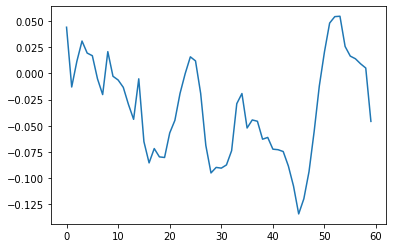

In [16]:
plt.plot(res[0])

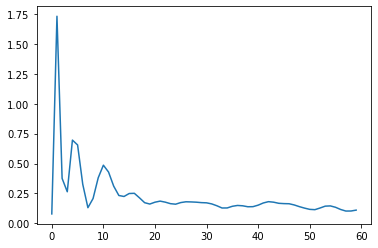

In [18]:
plt.plot(res[1])

# SGD N=128

In [86]:
LATENT_TO_OPTIMIZE = latent_vectors[32]
DIR_for_dump_data = './check_loss_sign'
punch_lr_at_reindex_by=1
reindex_latent_each = 10000

np.random.seed(101)
torch.manual_seed(0)
res = make_full_transformation(LATENT_TO_OPTIMIZE.detach(),
                         experiment_name=DIR_for_dump_data, decoder=decoder, model=predictor,
                         alpha_penalty=0.2, axis=0,
                         constraint_rad=0.05,
                         num_iters=200,
                         adjust_lr_every=20,
                         decreased_by=1.1, 
                         lr=0.2,
                         verbose=1,
                         N=128,
                         num_neignours_constr=10)

mesh time:  1.5745956897735596
three parts (321) of loss: 0.000, 0.000, 0.044
NN time:  9.565347909927368
Iter  0
gradient: first 0.539687 second 0.1934, full 0.5642, angle 46.42 
phys Loss: 0.0442
apenality: 0.0797
math_loss: 0.0793


mesh time:  1.5836176872253418
three parts (321) of loss: 0.000, 0.000, 0.031
NN time:  10.286942481994629
Iter  1
gradient: first 0.455487 second 0.1695, full 0.4512, angle 51.10 
phys Loss: 0.0315
apenality: 0.0751
math_loss: 0.0744


mesh time:  1.6434214115142822
three parts (321) of loss: 0.000, 0.000, 0.019
NN time:  10.406013011932373
Iter  2
gradient: first 0.505310 second 0.1627, full 0.4738, angle 55.20 
phys Loss: 0.0191
apenality: 0.0740
math_loss: 0.0737


mesh time:  1.6585590839385986
three parts (321) of loss: 0.000, 0.000, 0.026
NN time:  10.554206132888794
Iter  3
gradient: first 0.469981 second 0.1561, full 0.4174, angle 59.48 
phys Loss: 0.0259
apenality: 0.0757
math_loss: 0.0755


mesh time:  1.6637170314788818
three parts (321) of l

In [22]:
latent_plot = np.load("check_loss_sign/latent_plot.npy", allow_pickle=True)

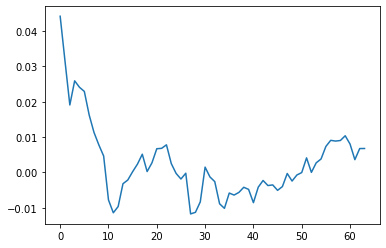

In [87]:
plt.plot(res[0])

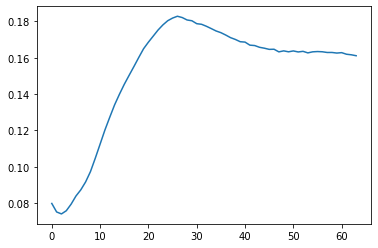

In [88]:
plt.plot(res[2])

In [35]:
#trimesh.load('check_loss_sign/meshes/00004.ply').show()

In [101]:
dire = "../Compare_optimisers/"
visual_Mesh(res[3][11], 256).export(dire + "sgdL006p11th.ply")
#N=256, loss=0.054, -2th
#N=128, loss=-0.0097, 11th, N=256, loss=0.062
np.save(dire + "sgdfull_record.npy", res)

In [17]:
dire = "../Compare_optimisers/"
#sgd = np.load(dire + "sgdfull_record.npy", allow_pickle=True)

#  Adam N=128 

In [36]:
LATENT_TO_OPTIMIZE = latent_vectors[32]
DIR_for_dump_data = './check_loss_sign'
punch_lr_at_reindex_by=1
reindex_latent_each = 10000

np.random.seed(101)
torch.manual_seed(0)
resa = make_full_transformation(LATENT_TO_OPTIMIZE.detach(),
                         experiment_name=DIR_for_dump_data, decoder=decoder, model=predictor,
                         alpha_penalty=0.2, axis=0,
                         constraint_rad=0.05,
                         num_iters=100,
                         adjust_lr_every=20,
                         decreased_by=1.1, 
                         lr=0.02,
                         verbose=1,
                         N=128,
                         num_neignours_constr=10)

mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.010
NN time: 8.8
Iter  0
gradient: first 0.476 second 0.055, full 0.431, angle 74.11 
phys Loss: 0.00958
apenality: 0.0247
math_loss: 0.0244


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, -0.003
NN time: 8.7
Iter  1
gradient: first 0.406 second 0.164, full 0.341, angle 62.32 
phys Loss: -0.00321
apenality: 0.0555
math_loss: 0.0553


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, -0.006
NN time: 8.8
Iter  2
gradient: first 0.504 second 0.229, full 0.420, angle 62.20 
phys Loss: -0.00649
apenality: 0.0886
math_loss: 0.0883


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, -0.006
NN time: 9.0
Iter  3
gradient: first 0.587 second 0.281, full 0.525, angle 58.32 
phys Loss: -0.00589
apenality: 0.1217
math_loss: 0.1216


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, -0.003
NN time: 9.1
Iter  4
gradient: first 0.549 second 0.315, full 0.481, angle 59.66 
phys Loss: -0.00299
apenality: 0.1499
ma

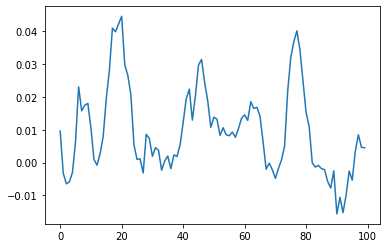

In [37]:
plt.plot(resa[0])

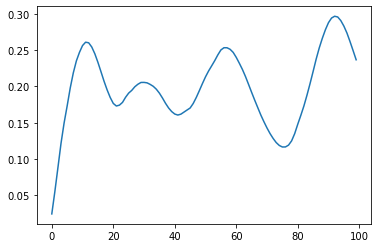

In [43]:
plt.plot(resa[1])

In [120]:
#m = visual_Mesh(resa[3][1], 256)
#m.show()
#m.export(dire + "adamL007p1th.ply")
# N=128, loss -0.08, 54th unreasonable, N = 256, loss=-0.02
# N=128, loss -0.005, 1th, lr = 0.02

# no gradient, pure interpolation 

In [122]:
LATENT_TO_OPTIMIZE = latent_vectors[32]
DIR_for_dump_data = './check_loss_sign'
punch_lr_at_reindex_by=1
reindex_latent_each = 10000

np.random.seed(101)
torch.manual_seed(0)
resa = make_full_transformation(LATENT_TO_OPTIMIZE.detach(),
                         experiment_name=DIR_for_dump_data, decoder=decoder, model=predictor,
                         alpha_penalty=0.2, axis=0,
                         constraint_rad=0.05,
                         num_iters=100,
                         adjust_lr_every=20,
                         decreased_by=1.1, 
                         lr=0.02,
                         verbose=1,
                         N=128,
                         num_neignours_constr=10)

mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.044
NN time: 8.9
Iter  0
gradient: first 0.000 second 0.193, full 0.193, angle nan 
phys Loss: 0.04419
apenality: 0.0797
math_loss: 0.0797


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.035
NN time: 8.3
Iter  1
gradient: first 0.000 second 0.138, full 0.138, angle nan 
phys Loss: 0.03513
apenality: 0.0504
math_loss: 0.0504


mesh time: 1.7 
three parts (321) of loss: 0.000, 0.000, 0.038
NN time: 8.4
Iter  2
gradient: first 0.000 second 0.098, full 0.098, angle nan 
phys Loss: 0.03838
apenality: 0.0357
math_loss: 0.0357


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.029
NN time: 8.3
Iter  3
gradient: first 0.000 second 0.081, full 0.081, angle nan 
phys Loss: 0.02918
apenality: 0.0318
math_loss: 0.0318


mesh time: 1.6 
three parts (321) of loss: 0.000, 0.000, 0.020
NN time: 8.2
Iter  4
gradient: first 0.000 second 0.090, full 0.090, angle nan 
phys Loss: 0.01956
apenality: 0.0332
math_loss: 0.0332




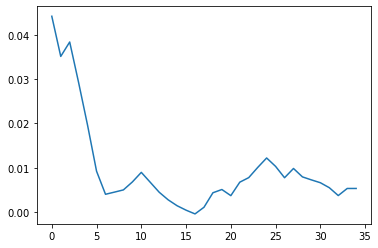

In [123]:
plt.plot(resa[0])

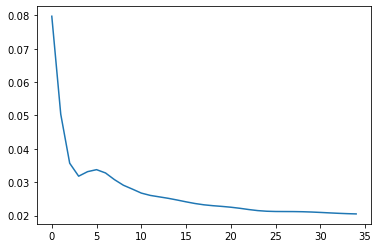

In [124]:
plt.plot(resa[1])

In [129]:
#m = visual_Mesh(resa[3][15], 256)
#m.show() 
# pure interpolation, loss=-0.0004, N=128, when N=256, loss=0.052
#m.export(dire + "no_gradient_L005p15th.ply")

In [14]:
dir = "check_loss_sign"
preds = np.load(dir + "/predictions/00004.npy")
mesh = trimesh.load_mesh(dir + "/meshes/00001.ply")
#loss_plot = np.load(dir + "/loss_plot.npy", allow_pickle=True)
#latent_plot = np.load(dir + "/latent_plot.npy", allow_pickle=True)
#penalty_plot = np.load(dir + "/penalty_plot.npy", allow_pickle=True)

In [16]:
#mesh.show()

In [ ]:

LATENT_TO_OPTIMIZE = latent_vectors[32]
DIR_for_dump_data = './data_exp_no_lr'
punch_lr_at_reindex_by=1
reindex_latent_each = 10000

np.random.seed(101)
make_full_transformation(LATENT_TO_OPTIMIZE.detach(),
                         experiment_name=DIR_for_dump_data, decoder=decoder, model=predictor,
                         alpha_penalty=0.2, axis=0,
                         constraint_rad=0.05,
                         num_iters=15,
                         adjust_lr_every=20,
                         decreased_by=1.1, 
                         lr=0.2,
                         verbose=1,
                         N=256,
                         num_neignours_constr=10)

first part of loss:  0.09731689
second part of loss:  0.0
third part of loss:  0.0
Iter  0 Loss:  0.09731689  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0002, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0797, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.592563 second 0.645671
together:  tensor(0.0796, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.08639855
second part of loss:  0.0
third part of loss:  0.0
Iter  1 Loss:  0.08639855  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0001, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0727, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.434708 second 0.460400
together:  tensor(0.0725, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09032741
second part of loss:  0.0
third part of loss:  0.0
Iter  2 Loss:  0.09032741  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-9.2462e-05, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0690, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.439687 second 0.433761
together:  tensor(0.0689, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09623494
second part of loss:  0.0
third part of loss:  0.0
Iter  3 Loss:  0.09623494  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-8.0399e-05, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0681, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.400617 second 0.364420
together:  tensor(0.0680, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09820058
second part of loss:  0.0
third part of loss:  0.0
Iter  4 Loss:  0.09820058  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-7.0867e-05, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0691, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.354286 second 0.307009
together:  tensor(0.0691, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.096129194
second part of loss:  0.0
third part of loss:  0.0
Iter  5 Loss:  0.096129194  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0001, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0701, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.341905 second 0.286260
together:  tensor(0.0700, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.0959214
second part of loss:  0.0
third part of loss:  0.0
Iter  6 Loss:  0.0959214  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0001, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0712, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.368958 second 0.295953
together:  tensor(0.0710, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09660533
second part of loss:  0.0
third part of loss:  0.0
Iter  7 Loss:  0.09660533  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0001, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0732, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.373103 second 0.294194
together:  tensor(0.0731, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09836705
second part of loss:  0.0
third part of loss:  0.0
Iter  8 Loss:  0.09836705  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0001, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0756, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.352191 second 0.248972
together:  tensor(0.0755, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.095050216
second part of loss:  0.0
third part of loss:  0.0
Iter  9 Loss:  0.095050216  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0001, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0785, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.372906 second 0.253887
together:  tensor(0.0784, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09614213
second part of loss:  0.0
third part of loss:  0.0
Iter  10 Loss:  0.09614213  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0002, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0826, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.355130 second 0.219288
together:  tensor(0.0824, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09243275
second part of loss:  0.0
third part of loss:  0.0
Iter  11 Loss:  0.09243275  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0002, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0865, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.341703 second 0.206178
together:  tensor(0.0863, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.08924888
second part of loss:  0.0
third part of loss:  0.0
Iter  12 Loss:  0.08924888  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0002, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0898, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.317619 second 0.169066
together:  tensor(0.0896, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.091126814
second part of loss:  0.0
third part of loss:  0.0
Iter  13 Loss:  0.091126814  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-0.0001, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0926, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.307111 second 0.152050
together:  tensor(0.0924, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


first part of loss:  0.09088944
second part of loss:  0.0
third part of loss:  0.0
Iter  14 Loss:  0.09088944  LD:  tensor(0.4676, device='cuda:0', requires_grad=True)
backward loss:  tensor(-7.4259e-05, device='cuda:0', grad_fn=<SumBackward0>)
penality:  tensor(0.0948, device='cuda:0', grad_fn=<MulBackward0>)
gradient: first 0.334267 second 0.176062
together:  tensor(0.0947, device='cuda:0', grad_fn=<AddBackward0>)




/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


In [18]:
dir = "check_loss_sign"
preds = np.load(dir + "/predictions/00000.npy")
mesh = trimesh.load_mesh(dir + "/meshes/00000.ply")
#loss_plot = np.load(dir + "/loss_plot.npy", allow_pickle=True)
#latent_plot = np.load(dir + "/latent_plot.npy", allow_pickle=True)
#penalty_plot = np.load(dir + "/penalty_plot.npy", allow_pickle=True)

In [26]:
pos = mesh['x']
cross_prod = (pos[mesh['face'][1]] - pos[mesh['face'][0]]).cross(
              pos[mesh['face'][2]] - pos[mesh['face'][0]])
area = -cross_prod[:, 0] / 2
lift = torch.mul(pressures, area)
torch.sum(lift[~torch.isnan(lift)])

PlyData((PlyElement('vertex', (PlyProperty('x', 'float'), PlyProperty('y', 'float'), PlyProperty('z', 'float'), PlyProperty('red', 'uchar'), PlyProperty('green', 'uchar'), PlyProperty('blue', 'uchar'), PlyProperty('alpha', 'uchar')), count=100733, comments=[]), PlyElement('face', (PlyListProperty('vertex_indices', 'uchar', 'int'),), count=201478, comments=[])), text=False, byte_order='<', comments=['github.com/mikedh/trimesh'], obj_info=[])

In [ ]:
punch_lr_at_reindex_by=1
reindex_latent_each = 10000
adjust_lr_every=20
decreased_by=1.1

# CMA line search

In [9]:
torch.manual_seed(0)

# 1 prepare data
latent = latent_vectors[32]

# 2 prepare model
#decoder = load_decoder(DIR_to_load_data, "decoderModel")
#predictor = load_pressure_predictor(DIR_to_load_data)

# init and setup one experiment
exp = single_experiment()
# One experiment: setup objective function
objective = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE, 128)
exp.set_objective(objective)
ln = line_search()
optParas = {
    'x0': latent,
    'alpha': 0.2,
    'beta': 0.01, 
    'max_iter': 10,
    'tol': 1e-1,              
    'verbose': False,
    'record': False
}
ln.set_parameters(optParas)
opt = cma_es(dim=256)
optParas ={'x0': latent,
           'std': torch.ones((256,), device=torch.device('cuda:0')) * 0.03, 
           'tol': 1e-6, 
           'adjust_func': ln, 
           'record': True, 
           'max_iter': 20,
           'cluster_size': 6,
           'verbose': True}
opt.set_parameters(optParas)
exp.set_optimizer(opt)
%time stats_ada = exp.do()



*******starting optimisation from intitial mean:  0.57972956
three parts (321) of loss: 0.000, 0.000, 0.044
forward time: 3.25
three parts (321) of loss: 0.000, 0.000, 0.008
forward time: 2.86
Iter  1
gradient: first 0.542 second 2.460, full 2.528, angle 44.51 
phys Loss: 0.00788
apenality: 1.1656
backward time: 5.32


three parts (321) of loss: 0.000, 0.000, 0.025
forward time: 2.96
three parts (321) of loss: 0.000, 0.000, 0.029
forward time: 2.95
three parts (321) of loss: 0.000, 0.000, 0.019
forward time: 2.93
three parts (321) of loss: 0.000, 0.000, 0.016
forward time: 3.04
three parts (321) of loss: 0.000, 0.000, 0.013
forward time: 2.86
three parts (321) of loss: 0.000, 0.000, 0.013
forward time: 3.05
three parts (321) of loss: 0.000, 0.000, 0.013
forward time: 2.91
three parts (321) of loss: 0.000, 0.000, 0.010
forward time: 2.90
three parts (321) of loss: 0.000, 0.000, 0.010
forward time: 2.85
three parts (321) of loss: 0.000, 0.000, 0.009
forward time: 2.88
three parts (321)

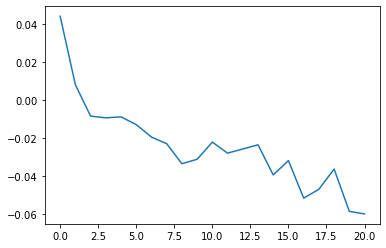

In [24]:
plt.plot(stats_ada['val'][:,0])

In [29]:
stats_ada.keys()

dict_keys(['inner', 'val', 'arg', 'x_adjust', 'evals', 'mean', 'std', 'status', 'optimal', 'optimum', 'found_optimal', 'found_optimum'])

In [26]:
#plt.plot(stats_ada['val'][:,0])

In [15]:
np.save('../Compare_optimisers/camlsfull.npy', stats_ada)

In [19]:
#m.export('../Compare_optimisers/cmals00098N.ply')

In [20]:
stats_ada['found_optimum']

tensor(-0.0601, device='cuda:0', grad_fn=<SelectBackward>)

In [17]:
m = visual_Mesh(stats_ada['found_optimal'], 256)  
# N=256 loss=-0.0098, unreasonable
# N=128 loss=-0.06
m.show()

latent loss. -0.009864 


In [ ]:
stats_ada

# cma + math_loss

In [14]:


torch.manual_seed(0)

# 1 prepare data
latent = latent_vectors[32]

# 2 prepare model
#decoder = load_decoder(DIR_to_load_data, "decoderModel")
#predictor = load_pressure_predictor(DIR_to_load_data)

# init and setup one experiment
exp = single_experiment()
# One experiment: setup objective function
objective = cfd_math_loss_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE, 128)
exp.set_objective(objective)
opt = cma_es(dim=256)
optParas ={'x0': latent,
           'std': torch.ones((256,), device=torch.device('cuda:0')) * 0.03, 
           'tol': 1e-6, 
           'adjust_func': do_nothing(), 
           'record': True, 
           'max_iter': 50,
           'cluster_size': 6,
           'verbose': True}
opt.set_parameters(optParas)
exp.set_optimizer(opt)
%time stats_ada = exp.do()




*******starting optimisation from intitial mean:  0.57972956
three parts (321) of loss: 0.000, 0.000, 0.044
phys Loss: 0.04419
apenality: 0.7974
forward time: 8.47


three parts (321) of loss: 0.000, 0.000, 0.000
phys Loss: 0.00017
apenality: 39.8878
forward time: 1.61


Surface level must be within volume data range.
three parts (321) of loss: 0.000, 0.000, -0.002
phys Loss: -0.00175
apenality: 49.1693
forward time: 2.08


Surface level must be within volume data range.
three parts (321) of loss: 0.000, 0.000, -0.005
phys Loss: -0.00510
apenality: 47.6074
forward time: 2.77


three parts (321) of loss: 0.000, 0.000, -0.000
phys Loss: -0.00045
apenality: 48.3606
forward time: 2.35


**************** cma iter:  1 **********************
loss: 39.88783
evals:  tensor(24.)


three parts (321) of loss: 0.000, 0.000, -0.021
phys Loss: -0.02110
apenality: 62.6911
forward time: 3.34


Surface level must be within volume data range.
Surface level must be within volume data range.
Surface leve

In [24]:
torch.manual_seed(0)

# 1 prepare data
latent = latent_vectors[32]

# 2 prepare model
#decoder = load_decoder(DIR_to_load_data, "decoderModel")
#predictor = load_pressure_predictor(DIR_to_load_data)

# init and setup one experiment
exp = single_experiment()
# One experiment: setup objective function
objective = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE)
exp.set_objective(objective)
ln = line_search()
optParas = {
    'x0': latent,
    'alpha': 0.1,
    'beta': 0.01, 
    'max_iter': 10,
    'tol': 1e-1,              
    'verbose': False,
    'record': False
}
ln.set_parameters(optParas)
opt = cma_es(dim=256)
optParas ={'x0': latent,
           'std': torch.ones((256,), device=torch.device('cuda:0')) * 0.03, 
           'tol': 1e-6, 
           'adjust_func': ln, 
           'record': True, 
           'max_iter': 10,
           'cluster_size': 6,
           'verbose': True}
opt.set_parameters(optParas)
exp.set_optimizer(opt)
%time stats_ada = exp.do()



*******starting optimisation from intitial mean:  0.57972956
The history saving thread hit an unexpected error (OperationalError('disk I/O error')).History will not be written to the database.
first part of loss:  0.025489114
second part of loss:  0.0
third part of loss:  0.0
Drag_point:  0.23935144
Drag*normal:  0.13766979 backward loss:  -0.000525395
latent shape:  torch.Size([256])
penalty:  1.240358
loss + penalty:  1.2398326
norm of grad 2.6245768 

first part of loss:  0.033386253
second part of loss:  0.0
third part of loss:  0.0
first part of loss:  0.033120185
second part of loss:  0.0
third part of loss:  0.0
first part of loss:  0.028824914
second part of loss:  0.0
third part of loss:  0.0
first part of loss:  0.025044112
second part of loss:  0.0
third part of loss:  0.0
first part of loss:  0.026342036
second part of loss:  0.0
third part of loss:  0.0
first part of loss:  0.026567124
second part of loss:  0.0
third part of loss:  0.0
first part of loss:  0.025711633
se

#  self-Adam

In [47]:
torch.all(latent_vectors[32] == LATENT_TO_OPTIMIZE)

tensor(True, device='cuda:0')

In [ ]:
torch.manual_seed(0)

# 1 prepare data
latent = latent_vectors[32]

# 2 prepare model
#decoder = load_decoder(DIR_to_load_data, "decoderModel")
#predictor = load_pressure_predictor(DIR_to_load_data)


# One experiment: setup objective function
objective = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE)
ad = adam(dim=256)
optParas = {
         'x0': latent,
         'alpha': 0.002,
         'beta_1': 0.9, 
         'beta_2': 0.999, 
         'epsilon': 1e-11, 
         'max_iter': 100,
         'tol': 1e-15,              
         'verbose': True,
         'record': True}
ad.set_parameters(optParas)
stats = ad.optimise(objective)

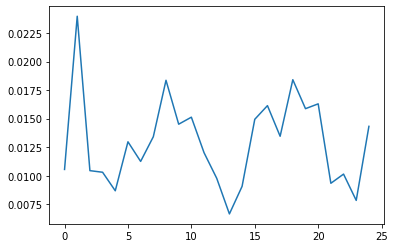

In [54]:
plt.plot(stats[2]['val'][1:])

In [74]:
np.save("../Compare_optimisers/longAdam.npy",resa)

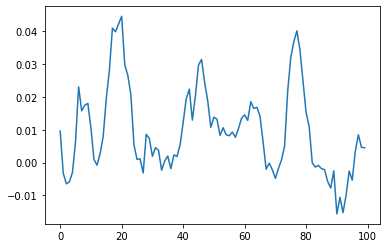

In [55]:
plt.plot(resa[0])

In [6]:
#m = visual_Mesh(torch.tensor(resa[3][90]).cuda(), 256)
#m.show()

()

# CMA

In [19]:
torch.manual_seed(0)

# 1 prepare data
latent = latent_vectors[32]

# 2 prepare model
#decoder = load_decoder(DIR_to_load_data, "decoderModel")
#predictor = load_pressure_predictor(DIR_to_load_data)

# init and setup one experiment
exp = single_experiment()
# One experiment: setup objective function
objective = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE, 256)
exp.set_objective(objective)
opt = cma_es(dim=256)
optParas ={'x0': latent,
           'std': torch.ones((256,), device=torch.device('cuda:0')) * 0.03, 
           'tol': 1e-6, 
           'adjust_func': do_nothing(), 
           'record': True, 
           'max_iter': 20,
           'cluster_size': 10,
           'verbose': True}
opt.set_parameters(optParas)
exp.set_optimizer(opt)
%time stats_ada = exp.do()



*******starting optimisation from intitial mean:  0.57972956
three parts (321) of loss: 0.000, 0.000, 0.097
forward time: 17.28
total iterations = 1, total evaluatios = 0
found minimum position = [-0.0445554  -0.02178257 -0.02520623  0.05292968  0.01182531  0.00869773
  0.01402882 -0.01671171 -0.01783873 -0.01641214], found minimum = 100.09732055664062


RuntimeError: CUDA out of memory. Tried to allocate 152.00 MiB (GPU 0; 11.91 GiB total capacity; 10.29 GiB already allocated; 41.56 MiB free; 10.64 GiB reserved in total by PyTorch)

In [35]:
torch.manual_seed(0)

# 1 prepare data
latent = latent_vectors[32]

# 2 prepare model
#decoder = load_decoder(DIR_to_load_data, "decoderModel")
#predictor = load_pressure_predictor(DIR_to_load_data)

# init and setup one experiment
exp = single_experiment()
# One experiment: setup objective function
objective = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE, 256)
exp.set_objective(objective)
opt = cma_es(dim=256)
optParas ={'x0': latent,
           'std': torch.ones((256,), device=torch.device('cuda:0')) * 0.03, 
           'tol': 1e-6, 
           'adjust_func': do_nothing(), 
           'record': True, 
           'max_iter': 5,
           'cluster_size': 10,
           'verbose': True}
opt.set_parameters(optParas)
exp.set_optimizer(opt)
%time stats_ada = exp.do()



*******starting optimisation from intitial mean:  0.57972956
three parts (321) of loss: 0.000, 0.000, 0.044
three parts (321) of loss: 0.000, 0.000, 0.008
three parts (321) of loss: 0.000, 0.000, 0.037
three parts (321) of loss: 0.000, 0.000, 0.039
three parts (321) of loss: 0.000, 0.000, 0.043
three parts (321) of loss: 0.000, 0.000, 0.030
three parts (321) of loss: 0.000, 0.000, 0.055
three parts (321) of loss: 0.000, 0.000, 0.025
three parts (321) of loss: 0.000, 0.000, 0.031
three parts (321) of loss: 0.000, 0.000, 0.029
three parts (321) of loss: 0.000, 0.000, 0.037
xxxxxxxxxxxxxxxxxx cma iter:  1
loss: 0.00788
evals:  tensor(10.)


three parts (321) of loss: 0.000, 0.000, 0.016
three parts (321) of loss: 0.000, 0.000, 0.025
three parts (321) of loss: 0.000, 0.000, 0.009
three parts (321) of loss: 0.000, 0.000, 0.003
three parts (321) of loss: 0.000, 0.000, 0.012
three parts (321) of loss: 0.000, 0.000, 0.022
three parts (321) of loss: 0.000, 0.000, 0.021
three parts (321) of lo

In [19]:
stats_cma = np.load("../Compare_optimisers/cma10run.npy", allow_pickle=True)

In [29]:
#stats_cma

In [21]:
opt = [-0.0766, -0.0535, -0.0425,  0.0906,  0.0174, -0.0506, -0.2529, -0.1414,
        -0.2402,  0.1015,  0.1598,  0.1276, -0.0019, -0.1143, -0.0296, -0.0864,
         0.0542,  0.0044, -0.0709, -0.0631,  0.0300,  0.0683,  0.2082,  0.3251,
         0.0831, -0.0058, -0.0157,  0.0553,  0.1283,  0.1857, -0.1187,  0.0853,
        -0.0972, -0.0214, -0.0781,  0.0448,  0.1784,  0.0062, -0.1935, -0.1418,
        -0.1368,  0.1077,  0.1709,  0.0776, -0.1665, -0.0364,  0.2562,  0.1215,
         0.0097,  0.0625, -0.1372, -0.1509, -0.2392, -0.0394,  0.0532, -0.0176,
        -0.0845,  0.0021, -0.0151,  0.3293, -0.0743,  0.0028,  0.0546,  0.0369,
        -0.0376,  0.1577, -0.1856,  0.0021, -0.0575,  0.2190, -0.0226, -0.1825,
        -0.3259,  0.1221,  0.0764, -0.0117, -0.1181, -0.0315,  0.0299, -0.0741,
         0.0459, -0.0094, -0.1290,  0.1604, -0.0880, -0.0113, -0.0071,  0.0114,
         0.0449, -0.0446, -0.0774, -0.0648,  0.1227, -0.0975, -0.0729, -0.0651,
         0.0221,  0.0403,  0.0192,  0.0015, -0.0067, -0.0661, -0.0566, -0.0586,
         0.0878, -0.0088,  0.0787, -0.0396,  0.0254,  0.0407,  0.0062,  0.0501,
         0.0284, -0.0114,  0.1186,  0.0188,  0.1824,  0.0857, -0.1987,  0.0196,
        -0.0799, -0.0528,  0.0029,  0.1120,  0.0761,  0.0233,  0.0183, -0.0328,
        -0.0654,  0.0374, -0.0231, -0.0831,  0.0716, -0.0124,  0.0951,  0.0209,
        -0.0972,  0.0494,  0.0275,  0.0177,  0.0887, -0.0917, -0.0159, -0.1040,
         0.0333, -0.0022, -0.1551,  0.1925, -0.0035,  0.0354,  0.0418,  0.0754,
         0.1042, -0.1351, -0.0880,  0.0509, -0.0655,  0.0675, -0.0874, -0.0208,
         0.0341, -0.1227, -0.0789,  0.0330,  0.0303,  0.0917,  0.0421,  0.0427,
        -0.1599, -0.1911,  0.0964,  0.2337, -0.1863, -0.1039,  0.0241, -0.0265,
         0.1440,  0.0356,  0.1219, -0.0616,  0.0308,  0.1281, -0.1329, -0.0185,
         0.0446,  0.0139,  0.0971, -0.0935,  0.0201, -0.0014, -0.1995, -0.0727,
        -0.0908,  0.0284,  0.0922,  0.0789, -0.0563,  0.1293, -0.0145,  0.0864,
        -0.0299, -0.1506,  0.0713, -0.0359,  0.0327, -0.0758, -0.0656,  0.0087,
         0.0616, -0.0060,  0.0509,  0.0542,  0.0721,  0.0368,  0.0167,  0.0100,
         0.1061, -0.0073, -0.1263, -0.0194,  0.0214, -0.0134, -0.2088, -0.1137,
         0.0342,  0.0803,  0.0494, -0.0813, -0.0382,  0.0794,  0.0208, -0.0678,
        -0.0142, -0.0504, -0.1215,  0.0244, -0.0469,  0.0793,  0.0244, -0.0300,
        -0.0238, -0.0176,  0.0585, -0.0247,  0.1106,  0.0081, -0.0020,  0.0494,
        -0.0356,  0.0651, -0.0272,  0.0128,  0.0467, -0.0100, -0.0539, -0.0574]

256

In [12]:
evals = stats_cma['evals_per_iter'].sum(axis=1)
eva = np.zeros(evals.shape)
eva[0] = evals[0]
for i in range(1, evals.shape[0]):
    eva[i] = evals[i] + eva[i-1]

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [36]:
eva

array([ 6., 12., 18., 24., 30., 36., 42., 48., 54., 60., 66.])

In [24]:
stats_cma.dtype = dict

In [22]:
import pickle
stats_cma = pickle.load(open("../Compare_optimisers/cma10run.npy",'rb'))

UnpicklingError: STACK_GLOBAL requires str

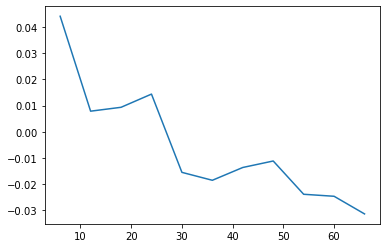

In [37]:
plt.plot(eva, stats_ada['val'][:,0])

In [4]:
np.save("cma_ln.npy", stats_ada['found_optimal'].cpu().numpy())
np.save("cma_ln_full_latent.npy", stats_ada['arg'])
np.save("cma_ln_full_stats.npy", stats_ada)

NameError: name 'np' is not defined

In [7]:
opt_ln = np.load("cma_ln.npy") ## -0.01 when N =256

In [ ]:
def visual_Mesh(ilatent, N):
    ply_mesh = create_mesh(decoder,
                        ilatent,
                        N=N,
                        max_batch=int(2 ** 10))
    points = torch.cuda.FloatTensor(np.hstack(( ply_mesh['vertex']['x'][:, None], 
                                            ply_mesh['vertex']['y'][:, None], 
                                            ply_mesh['vertex']['z'][:, None])))
    scaled_mesh = transform_mesh(points, ply_mesh, AvgTransform)
    pressure_field = predictor(scaled_mesh)
    loss = compute_lift_faces_diff(scaled_mesh, pressure_field)  
    print("latent loss. %f "%(loss))
    return get_trimesh_from_torch_geo_with_colors(scaled_mesh, pressure_field)

In [28]:
#visual_Mesh(torch.tensor(opt).cuda(), 256).export("../Compare_optimisers/cma001pBest.ply")

In [14]:
visual_Mesh(opt).show()

latent loss. -0.006829 


In [22]:
torch.manual_seed(0)

# 1 prepare data
latent = latent_vectors[32]

# 2 prepare model
#decoder = load_decoder(DIR_to_load_data, "decoderModel")
#predictor = load_pressure_predictor(DIR_to_load_data)

# init and setup one experiment
exp = single_experiment()
# One experiment: setup objective function
objective = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE)
exp.set_objective(objective)
opt = adam(dim=256)
optParas = {
         'x0': latent,
         'alpha': 0.2,
         'beta_1': 0.9, 
         'beta_2': 0.999, 
         'epsilon': 1e-11, 
         'max_iter': 6,
         'tol': 1e-6,              
         'verbose': True,
         'record': True}
opt.set_parameters(optParas)
exp.set_optimizer(opt)
%time stats_ada = exp.do()



*******starting optimisation from intitial point:  0.57972956
first part of loss:  0.09731689
second part of loss:  0.0
third part of loss:  0.0
Drag_point:  0.22352839
Drag*normal:  0.13567767 backward loss:  -0.00050923595
penalty:  0.797437
loss + penalty:  0.79692775
norm of grad 2.5732021 

first part of loss:  0.020302147
second part of loss:  0.0
third part of loss:  0.0
Drag_point:  0.10940667
Drag*normal:  0.041508444 backward loss:  -0.00011438874
penalty:  8.805174
loss + penalty:  8.805059
norm of grad 8.200061 

first part of loss:  0.029656217
second part of loss:  0.0
third part of loss:  0.0
Drag_point:  0.17294335
Drag*normal:  0.09234043 backward loss:  -0.00016345401
penalty:  1.5608435
loss + penalty:  1.56068
norm of grad 3.206675 

total evaluatios = 6
gradient at stop position = 3.2066750526428223,
modified graident = 7.762502193450928
found minimum position = 0.9498646855354309, found minimum = 0.029656216502189636
first part of loss:  0.07172572
second part o

In [23]:
np.save("saved_adam_res.npy", stats_ada['arg'])

In [27]:
stats_ada.shape

(4, 1, 256)

In [8]:
stats_ada = np.load("saved_adam_res.npy", allow_pickle=True)

In [13]:
ply_mesh = create_mesh(decoder,
                    torch.tensor(stats_ada[3]).cuda(),
                    N=256,
                    max_batch=int(2 ** 10))
points = torch.cuda.FloatTensor(np.hstack(( ply_mesh['vertex']['x'][:, None], 
                                        ply_mesh['vertex']['y'][:, None], 
                                        ply_mesh['vertex']['z'][:, None])))
scaled_mesh = transform_mesh(points, ply_mesh, AvgTransform)
pressure_field = predictor(scaled_mesh)
loss = compute_lift_faces_diff(scaled_mesh, pressure_field)  
print("latent loss. %f "%(loss))

NameError: name 'stats_ada' is not defined

In [23]:
[points[:,0].cpu().numpy() > 0.8][0]

array([False, False, False, ...,  True,  True,  True])

In [27]:
pressure_field[[points[:,0].cpu().numpy() > 0.5][0],0].mean()

tensor(-0.5467, device='cuda:0', grad_fn=<MeanBackward0>)

In [14]:
! nvidia-smi

Wed Aug 12 11:17:20 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.48.02    Driver Version: 440.48.02    CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  TITAN X (Pascal)    Off  | 00000000:04:00.0 Off |                  N/A |
| 23%   31C    P8     9W / 250W |   9139MiB / 12196MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   1  TITAN X (Pascal)    Off  | 00000000:05:00.0 Off |                  N/A |
| 23%   24C    P8     8W / 250W |  11875MiB / 12196MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   2  T

In [20]:
stats_ada['arg'][1][0, :10]

array([ 0.10427196, -0.17060995,  0.12362114, -0.09589767, -0.13700205,
        0.1575251 ,  0.16285618, -0.16553909,  0.13098864,  0.13241522],
      dtype=float32)

In [16]:
n = 3
latent = LATENT_TO_OPTIMIZE.clone()

objective = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE)
optimizer = torch.optim.Adam([latent], lr=0.2)
for i in range(n):
    optimizer.zero_grad()
    objective.func(latent)
    objective.dfunc(latent)
    optimizer.step()

first part of loss:  0.04418862
second part of loss:  0.0
third part of loss:  0.0
Drag_point:  0.28154516
Drag*normal:  0.16582887 backward loss:  -0.0003988812
penalty:  0.797437
loss + penalty:  0.79703814


AttributeError: 'NoneType' object has no attribute 'dim'

In [57]:
from library.experiments import *

In [74]:
latent_vectors = load_latent_vectors("starting_data", "latentCodes").detach()
LATENT_TO_OPTIMIZE = latent_vectors[32]
ply_mesh = create_mesh(decoder,
                    LATENT_TO_OPTIMIZE,
                    N=256,
                    max_batch=int(2 ** 6))
points = torch.cuda.FloatTensor(np.hstack(( ply_mesh['vertex']['x'][:, None], 
                                        ply_mesh['vertex']['y'][:, None], 
                                        ply_mesh['vertex']['z'][:, None])))
scaled_mesh = transform_mesh(points, ply_mesh, AvgTransform)
pressure_field = predictor(scaled_mesh)
loss = compute_lift_faces_diff(scaled_mesh, pressure_field)  
print("latent loss. %f "%(loss))

latent loss. 0.097317 


In [81]:
scaled_mesh['x']

tensor([[ 0.4413, -0.0722,  0.0605],
        [ 0.4412, -0.0723,  0.0605],
        [ 0.4412, -0.0722,  0.0633],
        ...,
        [-0.5436, -0.0430, -0.0397],
        [-0.5433, -0.0430, -0.0438],
        [-0.5432, -0.0388, -0.0063]], device='cuda:0')

In [90]:
pressure_field[points[:,0] > 0.8][:,0].mean()

tensor(0.2451, device='cuda:0', grad_fn=<MeanBackward0>)

In [102]:
pressure_field[points[:,0] > 0.9][:,0].mean()

tensor(2.4329, device='cuda:0', grad_fn=<MeanBackward0>)

In [104]:
pressure_field[points[:,0] > 0.2][:,0].mean()

tensor(-0.0572, device='cuda:0', grad_fn=<MeanBackward0>)

In [92]:
front = points[:,0] > 0.9

In [7]:
#list(pressure_field[-100:, 0])

In [100]:
color = np.zeros(points.shape[0])
color[front.cpu().numpy()] = 1
color = color * 8 - 4
color = torch.tensor(color.reshape(-1, 1))

In [101]:
get_trimesh_from_torch_geo_with_colors(scaled_mesh, color).show()

In [75]:
get_trimesh_from_torch_geo_with_colors(scaled_mesh, pressure_field).show()

In [ ]:
torch.save(stats_ada['arg'], "data_exp/self_adam.pt")

In [ ]:
torch.save(stats_ada['found_optimal'], "data_exp/self_adam_opt.pt")

In [ ]:
saved = torch.load("data_exp/self_adam.pt")

In [ ]:
distances, indeces = LATENT_KD_TREE.query(torch.tensor(saved[5]), k=10)
indeces

array([[1186,  292,  227,  216,  961,  534,  208,  599,  942,  778]])

In [ ]:
visual_Mesh(latent_vectors[1186]).show()

latent loss. 0.044571 


In [ ]:
distances

array([[1.55040018, 1.55741914, 1.57222002, 1.57889445, 1.58090429,
        1.59243881, 1.60400549, 1.61292108, 1.61685554, 1.6187264 ]])

In [ ]:
visual_Mesh(torch.tensor(saved[5]).cuda()).show()

latent loss. -0.064433 


In [ ]:
adjust_learning_rate(0.2, np.arange(15), decreased_by, adjust_lr_every)

array([0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2,
       0.2, 0.2])

In [ ]:
adjust_learning_rate(0.2, 29, decreased_by, adjust_lr_every)

0.18181818181818182

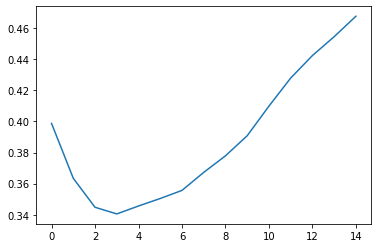

In [ ]:
plt.plot(lr_plot)

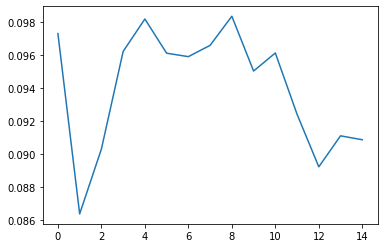

In [ ]:
plt.plot(loss_plot)

In [ ]:
mesh.show()

In [ ]:
np.random.seed(101)

LATENT_TO_OPTIMIZE = latent_vectors[32]
LATENT_TO_OPTIMIZE.requires_grad = True
cfd = cfd_obj(decoder, predictor, latent_vectors, AvgTransform, LATENT_KD_TREE)
print(cfd.func(LATENT_TO_OPTIMIZE))
%time torch.norm(cfd.dfunc(LATENT_TO_OPTIMIZE))

first part of loss:  tensor(0.0442, device='cuda:0', grad_fn=<AddBackward0>)
second part of loss:  tensor(0.0442, device='cuda:0', grad_fn=<AddBackward0>)
third part of loss:  tensor(0.0442, device='cuda:0', grad_fn=<AddBackward0>)
tensor(0.0442, device='cuda:0', grad_fn=<AddBackward0>)
if xyz original grad zero,  True
if latent grad zero, 1st backward True
if latent grad zero, 2nd backward True
pred_sdf sum:  tensor(-4.4190, device='cuda:0', grad_fn=<SumBackward0>)
normal:  tensor(145.0312, device='cuda:0')
dl_dx_i:  tensor(0.2815, device='cuda:0')
multipliers:  tensor(0.1658, device='cuda:0') backward loss:  tensor(-0.0004, device='cuda:0', grad_fn=<SumBackward0>)
penalty:  tensor(0.0797, device='cuda:0', grad_fn=<MulBackward0>)
backward: final:  tensor(0.0793, device='cuda:0', grad_fn=<AddBackward0>)
CPU times: user 996 ms, sys: 739 ms, total: 1.74 s
Wall time: 1.74 s


tensor(0.5642, device='cuda:0')

In [17]:
import numpy as np
import torch
from abc import ABC, abstractmethod


class optimizer(ABC):
    @abstractmethod
    def set_parameters(self, para):
        '''
        input: parameters, in dictionary
        '''
        pass
    @abstractmethod
    def optimise(self, obj):
        '''
        input: objective function class
        output: empirical found optimal, optimum, and statistics of procedure information
        '''
        pass
    
class adjust_optimizer(optimizer):
    def adjust(self, x0, obj):
        self.x0 = x0
        return self.optimise(obj)
    
class cma_es(adjust_optimizer):
    def __init__(self, dim=2):
        self.dim = dim
        paras = {'x0': torch.zeros((dim,)),
                 'std': torch.ones((dim,)) * 3, 
                 'tol': 1e-5, 
                 'adjust_func': do_nothing(), 
                 'record': False, 
                 'verbose': False}
        self.set_parameters(paras)
    def set_parameters(self, paras):
        self.paras = paras
        self.x0 = paras['x0'] 
        self.std = paras['std']
        self.tol = paras['tol']
        self.adjust_func = paras['adjust_func']
        self.max_iter = 400 if 'max_iter' not in paras.keys() else paras['max_iter']
        # set none to use default value 
        self.cluster_size = None if 'cluster_size' not in paras.keys() else paras['cluster_size']
        self.survival_size = None if 'survival_size' not in paras.keys() else paras['survival_size']
        self.record = True if 'record' not in paras.keys() else paras['record']
        self.verbose = True if 'verbose' not in paras.keys() else paras['verbose']
    def optimise(self, obj):
        '''
        @param obj: objective function class instance
        return arg: found minimum arguments
               val: found minimum value
               stats: collection of recorded statistics for post-analysis
        '''                  
        def update_mean(x):
            return (weights @ x).reshape(dim, 1)
        def update_ps(ps, sigma, C, mean, mean_old):
            return (1 - cs) * ps + torch.sqrt(cs * (2 - cs) * mueff) * invsqrtC @ (mean - mean_old) / sigma 
        def update_pc(pc, sigma, ps, mean, mean_old):
            hsig = (torch.norm(ps) / torch.sqrt(1 - (1 - cs)**(2 * iter_/lambda_)) / chiN < 1.4 + 2/(dim + 1)).int()
            return (1 - cc) * pc + hsig * torch.sqrt(cc * (2 - cc) * mueff) * (mean - mean_old) / sigma
        def update_C(C, pc, x, mean_old, sigma):
            hsig = (torch.norm(ps) / torch.sqrt(1 - (1 - cs)**(2 * iter_/lambda_)) / chiN < (1.4 + 2/(dim + 1))).int()
            artmp = (1 / sigma) * (x - mean_old.reshape(1, dim))
            return (1 - c1 - cmu) * C + c1 * (pc * pc.transpose(1,0) + (1 - hsig) * cc * (2 - cc) * C) + cmu * artmp.transpose(1,0) @ torch.diag(weights) @ artmp
        def update_sigma(sigma, ps):
            return sigma * torch.exp((cs / damps) * (torch.norm(ps)/ chiN - 1))
        def is_not_moving(arg, val, pre_arg, pre_val, tol):
            dis_arg = torch.norm(arg - pre_arg, dim=1).mean()
            dis_val = torch.abs(val - pre_val).mean()
            return (dis_arg < tol and dis_val < tol) 

        if self.verbose:
            print("\n\n*******starting optimisation from intitial mean: ", torch.norm(self.x0).detach().cpu().numpy())
        # User defined input parameters 
        dim = self.dim
        sigma = 0.3
        D = self.std / sigma
        mean = self.x0.reshape(dim, 1).detach()
        # the size of solutions group
        lambda_ = 4 + int(3 * np.log(dim)) if self.cluster_size == None else self.cluster_size  
        # only best "mu" solutions are used to generate iterations
        mu = int(lambda_ / 2) if self.survival_size == None else self.survival_size
        # used to combine best "mu" solutions                                               
        weights = np.log(mu + 1/2) - torch.log(torch.arange(mu, dtype=torch.float) + 1) 
        weights = (weights / torch.sum(weights)).cuda()   
        mueff = 1 / torch.sum(weights**2) 

        # Strategy parameter setting: Adaptation
        # time constant for cumulation for C
        cc = (4 + mueff / dim) / (dim + 4 + 2 * mueff / dim)  
        # t-const for cumulation for sigma control
        cs = (mueff + 2) / (dim + mueff + 5)  
        # learning rate for rank-one update of C
        c1 = 2 / ((dim + 1.3)**2 + mueff)    
        # and for rank-mu update
        cmu = min(1 - c1, 2 * (mueff - 2 + 1 / mueff) / ((dim + 2)**2 + mueff))  
        # damping for sigma, usually close to 1  
        damps = 1 + 2 * max(0, torch.sqrt((mueff - 1)/( dim + 1)) - 1) + cs     


        # Initialize dynamic (internal) strategy parameters and constants
        # evolution paths for C and sigma
        pc = torch.zeros((dim, 1), device=torch.device('cuda:0'))     
        ps = torch.zeros((dim, 1), device=torch.device('cuda:0')) 
        # B defines the coordinate system
        B = torch.eye(int(dim), device=torch.device('cuda:0'))       
        # covariance matrix C
        C = B * torch.diag(D**2) * B.transpose(1, 0)
        # C^-1/2 
        invsqrtC = B * torch.diag(D**-1) * B.transpose(1, 0)
        # expectation of ||N(0,I)|| == norm(randn(N,1)) 
        chiN = dim**0.5 * (1 - 1/(4 * dim) + 1 / (21 * dim**2))  

        # --------------------  Initialization --------------------------------  
        x, x_old, fs = torch.zeros((lambda_, dim), device=torch.device('cuda:0')),  \
                        torch.zeros((lambda_, dim), device=torch.device('cuda:0')), \
                        torch.zeros((lambda_,), device=torch.device('cuda:0'))
        stats = {}
        inner_stats = {}
        stats['inner'] = []
        stats['val'], stats['arg'] = [], []
        stats['x_adjust'] = []
        iter_eval, stats['evals'] = torch.zeros((lambda_,)), []
        inner_stats = [{}] * lambda_
        stats['mean'], stats['std'] = [], []
        stats['status'] = None
        iter_, eval_ = 0, 0
        # initial data in record
        cand = mean.squeeze()
        fs[0] = obj.func(cand)
        for i in range(lambda_):
            fs[i] = fs[0]
            x[i] = cand
            x_old[i] = cand
        idx = torch.argsort(fs)
        x_ascending = x[idx]
        if self.record:
            stats['inner'].append(inner_stats)
            stats['arg'].append(x_ascending.cpu().numpy())
            stats['val'].append(fs[idx].detach().cpu().numpy())
            stats['mean'].append(mean.cpu().numpy())
            #stats['std'].append((sigma * B @ torch.diag(D)).cpu().numpy())
            stats['evals'].append(1)
            #stats['x_adjust'].append(np.vstack((x_old[idx].transpose(1,0).cpu().numpy(), x[idx].transpose(1,0).cpu().numpy())))
        arg = x_ascending
        val = fs[idx]
        pre_arg = x_ascending
        pre_val = fs[idx]
        best_val = fs[0] + 1e2
        best_arg = x[0,:]
        
        # optimise by iterations
        try:
            while iter_ < self.max_iter:
                iter_ += 1
                # generate candidate solutions with some stochastic elements
                for i in range(lambda_):
                    candidate_old = (mean + sigma * B @ torch.diag(D) @ torch.randn(dim, 1).cuda()).squeeze()
                    #print("candidate: ", candidate_old, candidate_old.requires_grad)
                    #ad.x0 = candidate_old.requires_grad_(True)
                    #candidate_new, val, inner_stats[i] = ad.optimise(obj)
                    try:
                        candidate_new, val, inner_stats[i] = self.adjust_func.adjust(candidate_old.requires_grad_(True), obj)
                    except ValueError as err:
                        print(str(err))
                        if str(err) == "Surface level must be within volume data range.":
                            candidate_new = candidate_old
                            val = best_val + 5
                            inner_stats[i] = {'evals': 10}
                        else:
                            raise(str(err))
                    x[i] = candidate_new.detach()
                    x_old[i] = candidate_old.detach()
                    fs[i] = val.detach()
                    #print("grad? ", x[i].requires_grad, x_old[i].requires_grad, fs[i].requires_grad, B.requires_grad, D.requires_grad)
                    eval_ += inner_stats[i]['evals']
                    iter_eval[i] = inner_stats[i]['evals']
               # sort the value and positions of solutions 
                idx = torch.argsort(fs)
                x_ascending = x[idx]

                # update the parameter for next iteration
                mean_old = mean
                mean = update_mean(x_ascending[:mu])
                # print("mean old and new: ", mean_old, mean)
                ps =   update_ps(ps, sigma, C, mean, mean_old)
                pc =   update_pc(pc, sigma, ps, mean, mean_old)
                sigma = update_sigma(sigma, ps)
                
                C =    update_C(C, pc, x_ascending[:mu], mean_old, sigma)
                C = (torch.triu(C) + torch.triu(C, 1).transpose(1,0))
                D, B = torch.eig(C, eigenvectors=True)
                D = torch.sqrt(D[:,0])
                invsqrtC = B @ torch.diag(D**-1) @ B.transpose(1,0)
                arg = x_ascending
                val = fs[idx]
                if self.verbose:
                    print("**************** cma iter: ", iter_, "**********************")
                    print("loss: %.5f"%val[0].item())
                    print("evals: ", iter_eval.sum())
                    #print("latent: ", x_ascending[0].cpu().numpy())
                    #print("mean: ", mean)
                    #print("sigma: ", sigma)
                    #print("std: ", D)
                    print("\n")
                # record data during process for post analysis
                if self.record:
                    #stats['inner'].append(inner_stats)
                    stats['arg'].append(x_ascending[0].cpu().numpy())
                    stats['val'].append(fs[idx].detach().cpu().numpy())
                    #stats['mean'].append(mean.cpu().numpy())
                    #stats['std'].append((sigma * B @ torch.diag(D)).cpu().numpy())
                    stats['evals'].append(iter_eval.sum() + stats['evals'][-1])
                    #stats['x_adjust'].append(np.vstack((x.transpose(1,0).cpu().numpy(), x_old.transpose(1,0).cpu().numpy())))
                # stopping condition  
                if best_val > val[0]:
                    best_val = val[0]
                    best_arg = arg[0]              
                # check the stop condition
                if torch.max(D) > (torch.min(D) * 1e4):
                    stats['status'] = 'diverge'
                    print('diverge, concentrate in low dimension manifold')
                    break
                if is_not_moving(arg, val, pre_arg, pre_val, self.tol) :
                    break
                pre_arg = arg
                pre_val = val
        except np.linalg.LinAlgError as err:
            stats['status'] = 'diverge'
            print('diverge, raise LinAlgError!')
        finally:
            if self.verbose:
                #print('eigenvalue of variance = {}'.format(D))
                print('total iterations = {}, total evaluatios = {}'.format(iter_, eval_))
                print('found minimum position = {}, found minimum = {}'.format(best_arg.detach().cpu().numpy()[:10], best_val.detach().cpu().numpy()))

        # carry statistics info before quit
        if self.record:
            stats['arg'] = np.array(stats['arg'])
            stats['val'] = np.array(stats['val'])
            #stats['mean'] = np.array(stats['mean'])
            #stats['std'] = np.array(stats['std'])
            stats['evals'] = np.array(stats['evals'])
            #stats['x_adjust'] = np.array(stats['x_adjust'])
        stats['evals'] = eval_
        return best_arg, best_val, stats
    
class do_nothing(adjust_optimizer):
    def __init__(self, dim=2, verbose=False):
        self.stats = {}
        self.stats['status'] = None
        self.stats['evals'] = 1
        self.verbose = False
        self.record = False
        self.x0 = torch.zeros((dim,))
        self.verbose = verbose
    def set_parameters(self, paras):
        self.verbose = paras['verbose']
        self.record = paras['record']
    def optimise(self, obj):
        self.x0.requires_grad_(False)
        if self.verbose:
            print("\n*******starting optimisation from intitial point: ", torch.norm(self.x0).detach().cpu().numpy())
        return self.x0, obj.func(self.x0), self.stats
    
class adam(adjust_optimizer):
    def __init__(self, alpha=0.01, verbose=False, dim=2):
        self.alpha = 0.01
        self.beta_1 = 0.9
        self.beta_2 = 0.999
        self.epsilon = 1e-11
        self.max_iter = 10000
        self.tol = 1e-3
        self.verbose = verbose
        self.record = False
        self.x0 = torch.zeros((dim,))
        
    def set_parameters(self, paras):
        self.paras = paras
        self.x0 = paras['x0']
        self.alpha = paras['alpha']
        self.beta_1 = paras['beta_1']
        self.beta_2 = paras['beta_2']
        self.epsilon = paras['epsilon']
        self.max_iter = paras['max_iter']
        self.tol = paras['tol']
        self.verbose = True if 'verbose' not in paras.keys() else paras['verbose']
        self.record = False if 'record' not in paras.keys() else paras['record']
        
    def optimise(self, obj):
        m_t = 0 
        v_t = 0 
        eval_cnt = 0
        x = self.x0
        stats = {}
        stats['status'] = None
        stats['gradient_before_after'] = []
        stats['arg'] = []
        stats['val'] = []
        if self.record:
            stats['arg'].append(x.clone().detach().cpu().numpy())
            stats['val'].append(10)
            stats['gradient_before_after'].append([np.ones(max(x.shape)), np.ones(max(x.shape))])
        if self.verbose:
            print("\n\n*******starting optimisation from intitial point: ", torch.norm(self.x0).detach().cpu().numpy())
        while eval_cnt < self.max_iter:					#till it gets converged
            eval_cnt += 1
            x = x.detach().requires_grad_(True)
            loss = obj.func(x)
            g_t = obj.dfunc(x)		#computes the gradient of the stochastic function
            m_t = self.beta_1*m_t + (1-self.beta_1)*g_t	#updates the moving averages of the gradient
            v_t = self.beta_2*v_t + (1-self.beta_2)*(g_t*g_t)	#updates the moving averages of the squared gradient
            m_cap = m_t/(1-(self.beta_1**eval_cnt))		#calculates the bias-corrected estimates
            v_cap = v_t/(1-(self.beta_2**eval_cnt))		#calculates the bias-corrected estimates
            x_prev = x.clone()								
            est_df = (m_cap)/(torch.sqrt(v_cap)+self.epsilon)
            with torch.no_grad():
                x -= self.alpha * est_df 	#updates the parameters
            #if self.verbose:
            #    print("iter: ", eval_cnt)
            #    print("loss: ", loss.item())
            #    print("\n")
            if self.record:
                stats['arg'].append(x.clone().detach().cpu().numpy())
                stats['val'].append(loss.item())
                #stats['gradient_before_after'].append([g_t, est_df])
            if(torch.norm(x-x_prev) < self.tol):		#checks if it is converged or not
                break
        print("*************end of adam optimiser")
        if self.verbose:
            print('total evaluatios = {}'.format(eval_cnt))
            print('gradient at stop position = {},\nmodified graident = {}'.format(torch.norm(g_t).item(), torch.norm(est_df).item()))
            print('found minimum position = {}, found minimum = {}'.format(torch.norm(x).item(), loss))
        stats['arg'] = np.array(stats['arg'])
        stats['val'] = np.array(stats['val'])
        #stats['gradient_before_after'] = np.array(stats['gradient_before_after'])
        stats['evals'] = eval_cnt
        return x, obj.func(x), stats
    
class line_search(adjust_optimizer):
    def __init__(self, alpha=1, beta=0.1):
        self.alpha = alpha
        self.beta = beta
        self.max_iter = 100
        self.tol = 1e-2
        self.verbose = False
        self.record = False
     
    def set_parameters(self, paras):
        self.paras = paras
        self.x0 = paras['x0']
        self.alpha = paras['alpha']
        self.beta = paras['beta']
        self.max_iter = paras['max_iter']
        self.tol = paras['tol']
        self.verbose = True if 'verbose' not in paras.keys() else paras['verbose']
        self.record = True if 'record' not in paras.keys() else paras['record']
    def optimise(self, obj):
        '''
        @param x0: initial point position
        @param alpha: initial step size
        @param beta: control the armijo condition
        @return x: point position after moving to local minimum
        '''
        x = self.x0.detach().squeeze().requires_grad_(True)
        alpha_ = self.alpha
        tao = 0.5
        fx = obj.func(x)
        p = - obj.dfunc(x)
        fnx = obj.func(x + alpha_ * p)
        eval_cnt = 3
        stats = {}
        stats['status'] = None
        stats['gradient'] = []
        stats['arg'] = []
        stats['val'] = []
        if self.record:
            stats['arg'].append(x.clone().detach().cpu().numpy())
            stats['val'].append(fx.detach().cpu().numpy())
            stats['gradient'].append(-p.cpu().numpy())
        if self.verbose:
            print("\n*******starting optimisation from intitial point: ", torch.norm(self.x0).detach().cpu().numpy())
        for k in range(self.max_iter):
            #alpha_ = self.alpha
            while fnx > fx + alpha_ * self.beta * (-p @ p):
                alpha_ *= tao
                fnx = obj.func(x + alpha_ * p)
                eval_cnt += 1
            with torch.no_grad():
                x += alpha_ * p
            fx = fnx
            x = x.detach().requires_grad_(True)
            p = -obj.dfunc(x)
            fnx = obj.func(x + alpha_ * p)
            eval_cnt += 1
            if self.verbose:
                print("iter: ", k)
                print("x: ", x)
                print("loss: ", fx.item(), fnx.item())
                print("gradient: ", p)
                print("stepsize: ", alpha_)
                print("\n")
            if self.record:
                stats['arg'].append(x.clone().detach().cpu().numpy())
                #print(eval_cnt, stats['arg'])
                
                stats['val'].append(fx.detach().cpu().numpy())
                stats['math_loss'].append(obj.math_loss)
                #stats['gradient'].append(-p.detach().cpu().numpy())
            if torch.isnan(p.sum()):
                break
            if torch.norm(p) < self.tol or torch.norm(fnx - fx) < 1e-3:
                break
        stats['evals'] = eval_cnt
        print("*************end of line search optimiser")
        if self.verbose:
            print('total evaluatios = {}'.format(eval_cnt))
            print('gradient at stop position = {}'.format(-p.detach().cpu().numpy()))
            print('found minimum position = {}, found minimum = {}'.format(x.detach().cpu().numpy(), fx.detach().cpu().numpy()))
        stats['arg'] = np.array(stats['arg'])
        stats['val'] = np.array(stats['val'])
        stats['gradient'] = np.array(stats['gradient'])
        stats['inner_math_loss'] = obj.math_loss
        return x, fnx, stats

In [15]:
class cfd_obj(objective_func):
    def __init__(self, decoder, p_predictor, latent_vectors, AvgTransform, LATENT_KD_TREE, N):
        self.N_MARCHING_CUBE = N
        self.regl2 = 1e-3
        self.iter = 0
        self.quick = True
        self.AvgTransform = AvgTransform
        self.decoder = decoder
        self.pressure_pred = p_predictor
        self.constraint_rad = 0.05
        self.num_neignours_constr = 10
        self.latent_vectors = latent_vectors
        self.LATENT_KD_TREE = LATENT_KD_TREE
        self.alpha_penalty = 2
        self.optimum = 0
        self.verbose = True
        self.optimal = latent_vectors[32].detach().cpu().numpy()
        self.i = 0
    
    def func(self, latent):
        # from latent to xyz
        start = time.time()
        ply_mesh = create_mesh(self.decoder, latent, N=self.N_MARCHING_CUBE, max_batch=int(2 ** 15))
        points = torch.Tensor(np.hstack(( ply_mesh['vertex']['x'][:, None], 
                                            ply_mesh['vertex']['y'][:, None], 
                                            ply_mesh['vertex']['z'][:, None]))).cuda()
        # from mesh to pressure field
        #points.requires_grad = True
        self.xyz_original = points
        scaled_mesh = transform_mesh(points, ply_mesh, self.AvgTransform)
        scaled_mesh['x'] = scaled_mesh['x'].detach().requires_grad_(True)
        self.xyz_upstream = scaled_mesh['x'] 
        pressure_field = self.pressure_pred(scaled_mesh)
        loss = calculate_loss(scaled_mesh, pressure_field, constraint_rad=self.constraint_rad)
        self.last_loss = loss
        self.last_latent = latent
        end = time.time()
        print("forward time: %.2f"%(end-start))
        return loss
    
    def dfunc(self, latent):
        start = time.time()
        if latent.grad is not None:
            latent.grad.detach_()
            latent.grad.zero_()
        # step 1
        if self.quick and self.last_latent is not None and torch.all(latent == self.last_latent):
            loss = self.last_loss
        else:
            loss = self.func(latent)
        loss.backward()
        dL_dx_i = self.xyz_upstream.grad
        
        # step 2
        # calculate mesh normal
        xyz = self.xyz_original
        xyz.requires_grad = True
        
        #latent_inputs = latent.expand(xyz.shape[0], -1)
        latent_inputs = latent.detach().expand(xyz.shape[0], -1)
        inputs = torch.cat([latent_inputs, xyz], 1).cuda()      #Add .cuda() if you want to run on GPU
        #first compute normals
        pred_sdf = self.decoder(inputs)
        
        loss_normals = torch.sum(pred_sdf)
        loss_normals.backward(retain_graph = True)
        normals = xyz.grad#/torch.norm(xyz.grad, 2, 1).unsqueeze(-1)

        
        # step 3
        # now assemble inflow derivative
        #latent.grad.zero_()
        latent_inputs = latent.expand(xyz.shape[0], -1)
        inputs = torch.cat([latent_inputs, xyz.detach()], 1).cuda()      #Add .cuda() if you want to run on GPU
        pred_sdf = self.decoder(inputs)

        multipliers = -torch.matmul(dL_dx_i.unsqueeze(1), normals.unsqueeze(-1)).squeeze(-1)
        loss_backward = torch.sum(multipliers * pred_sdf)
        loss_backward.backward()
        first_d = latent.grad.clone().squeeze()
        
        # artificial loss
        # Soft-constraints
        distances, indeces = self.LATENT_KD_TREE.query(latent.cpu().detach().reshape(1,-1), k=self.num_neignours_constr)
        apenalty = self.alpha_penalty * torch.sum((latent - self.latent_vectors[indeces.squeeze()]) ** 2, dim=2).mean()
        apenalty.backward()
        second_d = latent.grad.squeeze() - first_d
        self.math_loss = (loss_backward + apenalty).detach()
    
        # Backpropagate
        #loss_backward.backward()
        
        if self.verbose:
            self.i+=1
            print('Iter ', self.i)
            print("gradient: first %.3f second %.3f, full %.3f, angle %.2f "%(torch.norm(first_d), torch.norm(second_d), \
                torch.norm(latent.grad), 90 / np.pi * torch.acos(first_d.dot(second_d) / torch.norm(first_d)/torch.norm(second_d))))
            print('phys Loss: %.5f'%loss.item())
            print('apenality: %.4f'%apenalty.item())
            #print("math_loss: %.4f"%((loss_backward).item()))
        end = time.time()
        print("backward time: %.2f"%(end-start))
        print("\n")
        return latent.grad

In [16]:
class cfd_math_loss_obj(objective_func):
    def __init__(self, decoder, p_predictor, latent_vectors, AvgTransform, LATENT_KD_TREE, N):
        self.N_MARCHING_CUBE = N
        self.regl2 = 1e-3
        self.iter = 0
        self.quick = True
        self.AvgTransform = AvgTransform
        self.decoder = decoder
        self.pressure_pred = p_predictor
        self.constraint_rad = 0.05
        self.num_neignours_constr = 10
        self.latent_vectors = latent_vectors
        self.LATENT_KD_TREE = LATENT_KD_TREE
        self.alpha_penalty = 2
        self.optimum = 0
        self.verbose = True
        self.optimal = latent_vectors[32].detach().cpu().numpy()
        self.i = 0
    
    def func(self, latent):
        # from latent to xyz
        start = time.time()
        self.last_latent = latent
        ply_mesh = create_mesh(self.decoder, latent, N=self.N_MARCHING_CUBE, max_batch=int(2 ** 15))
        points = torch.Tensor(np.hstack(( ply_mesh['vertex']['x'][:, None], 
                                            ply_mesh['vertex']['y'][:, None], 
                                            ply_mesh['vertex']['z'][:, None]))).cuda()
        # from mesh to pressure field
        #points.requires_grad = True
        scaled_mesh = transform_mesh(points, ply_mesh, self.AvgTransform)
        scaled_mesh['x'] = scaled_mesh['x'].detach().requires_grad_(True)
        pressure_field = self.pressure_pred(scaled_mesh)
        loss = calculate_loss(scaled_mesh, pressure_field, constraint_rad=self.constraint_rad)

        loss.backward()
        dL_dx_i = scaled_mesh['x'].grad
        
        
        points.requires_grad = True
        
        #latent_inputs = latent.expand(xyz.shape[0], -1)
        latent_inputs = latent.detach().expand(points.shape[0], -1)
        inputs = torch.cat([latent_inputs, points], 1).cuda()  
        
        #first compute normals
        pred_sdf = self.decoder(inputs)
        loss_normals = torch.sum(pred_sdf)
        loss_normals.backward(retain_graph = True)
        normals = points.grad/torch.norm(points.grad, 2, 1).unsqueeze(-1)

        latent_inputs = latent.expand(points.shape[0], -1)
        inputs = torch.cat([latent_inputs, points.detach()], 1).cuda()      #Add .cuda() if you want to run on GPU
        pred_sdf = self.decoder(inputs)

        multipliers = -torch.matmul(dL_dx_i.unsqueeze(1), normals.unsqueeze(-1)).squeeze(-1)
        loss_backward = torch.sum(multipliers * pred_sdf)
        
        # artificial loss
        # Soft-constraints
        distances, indeces = self.LATENT_KD_TREE.query(latent.cpu().detach().reshape(1,-1), k=self.num_neignours_constr)
        apenalty = self.alpha_penalty * torch.sum((latent - self.latent_vectors[indeces.squeeze()]) ** 2, dim=2).mean()

        loss_backward += apenalty
        self.last_loss = loss_backward
        end = time.time()
        if self.verbose:
            print('phys Loss: %.5f'%loss.item())
            print('apenality: %.4f'%apenalty.item())
        print("forward time: %.2f"%(end-start))
        print("\n")
        return loss_backward
    
    def dfunc(self, latent):
        start = time.time()
        if latent.grad is not None:
            latent.grad.detach_()
            latent.grad.zero_()
        # step 1
        if self.quick and self.last_latent is not None and torch.all(latent == self.last_latent):
            loss = self.last_loss
        else:
            loss = self.func(latent)
        loss.backward()
        end = time.time()
        print("backward time: %.2f"%(end-start))
        print("\n")
        return self.last_latent.grad